### Import libraries

In [1]:
import pathlib
import pandas as pd
import numpy as np

import sys
sys.path.append("../utils")
from load_utils import compile_mitocheck_batch_data, split_data
from analysis_utils import get_2D_umap_embeddings, show_2D_umap_from_embeddings

2023-03-07 12:59:42.577157: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0


### Compile control data

In [2]:
# get 10% of negative control features
negative_control_data_path = pathlib.Path("../1.idr_streams/extracted_features/negative_control_data/merged_features")
negative_control_data = compile_mitocheck_batch_data(negative_control_data_path)
negative_control_data = negative_control_data.sample(frac=0.1, random_state=0)

# get 10% of positive control features
positive_control_data_path = pathlib.Path("../1.idr_streams/extracted_features/positive_control_data/merged_features")
positive_control_data = compile_mitocheck_batch_data(positive_control_data_path)
positive_control_data = positive_control_data.sample(frac=0.1, random_state=0)

# combine negative and positive control features
control_data = pd.concat([negative_control_data, positive_control_data])
# shuffle data so negative/positive controls are not ordered
control_data = control_data.sample(frac=1, random_state=0)
control_data

,Location_Center_X,Location_Center_Y,Metadata_Plate,Metadata_Well,Metadata_Site,Metadata_Frame,Metadata_Plate_Map_Name,Metadata_DNA,Metadata_Gene,Metadata_Gene_Replicate,...,DP__efficientnet_1270,DP__efficientnet_1271,DP__efficientnet_1272,DP__efficientnet_1273,DP__efficientnet_1274,DP__efficientnet_1275,DP__efficientnet_1276,DP__efficientnet_1277,DP__efficientnet_1278,DP__efficientnet_1279
172534,263,694,LT0060_52,363,1,38,LT0060_52_363,LT0060_52/LT0060_52_363_38.tif,negative control,1,...,-0.074803,-0.168559,-0.156685,0.223909,-0.208912,-0.189094,-0.035518,-0.088079,-0.130374,0.554991
102351,1260,88,LT0108_01,352,1,45,LT0108_01_352,LT0108_01/LT0108_01_352_45.tif,negative control,1,...,-0.134989,-0.199281,-0.210422,0.973043,-0.170285,0.778406,-0.045612,-0.113169,-0.167812,0.156632
501579,1294,348,LT0124_19,74,1,46,LT0124_19_74,LT0124_19/LT0124_19_74_46.tif,negative control,1,...,-0.115480,-0.069517,-0.173868,0.539746,-0.072211,0.441658,-0.064820,-0.141095,-0.173988,0.302070
537272,449,48,LT0155_05,26,1,42,LT0155_05_26,LT0155_05/LT0155_05_26_42.tif,negative control,1,...,-0.049357,-0.052558,-0.185753,-0.033871,-0.188369,0.300615,-0.074330,-0.140716,-0.101397,0.865951
602525,733,407,LT0013_11,52,1,56,LT0013_11_52,LT0013_11/LT0013_11_52_56.tif,ENSG00000149503,1,...,-0.086836,-0.218246,-0.174834,0.334040,-0.208430,0.070417,-0.041495,-0.113278,-0.178198,0.730198
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
140837,737,785,LT0016_15,352,1,39,LT0016_15_352,LT0016_15/LT0016_15_352_39.tif,negative control,1,...,-0.054955,-0.058222,0.027978,-0.167255,-0.215637,-0.215834,-0.040732,-0.163507,-0.100414,1.187917
459769,278,157,LT0133_01,384,1,61,LT0133_01_384,LT0133_01/LT0133_01_384_61.tif,COPB,1,...,-0.076731,0.242241,0.350003,-0.013603,-0.038062,-0.139772,-0.107223,-0.123162,-0.079601,0.572870
367367,1299,718,LT0122_51,52,1,35,LT0122_51_52,LT0122_51/LT0122_51_52_35.tif,ENSG00000149503,1,...,-0.108454,-0.119596,-0.187160,0.877417,-0.168186,0.207269,-0.052130,-0.134685,-0.185350,1.123901
537312,1270,149,LT0110_07,4,1,31,LT0110_07_4,LT0110_07/LT0110_07_4_31.tif,ENSG00000149503,1,...,-0.102431,-0.155022,-0.133213,0.704910,-0.208961,0.095872,-0.045878,-0.085467,-0.133635,0.744844


### Create 2D umaps colored by metadata (CP)

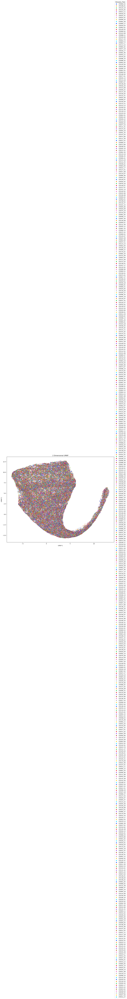

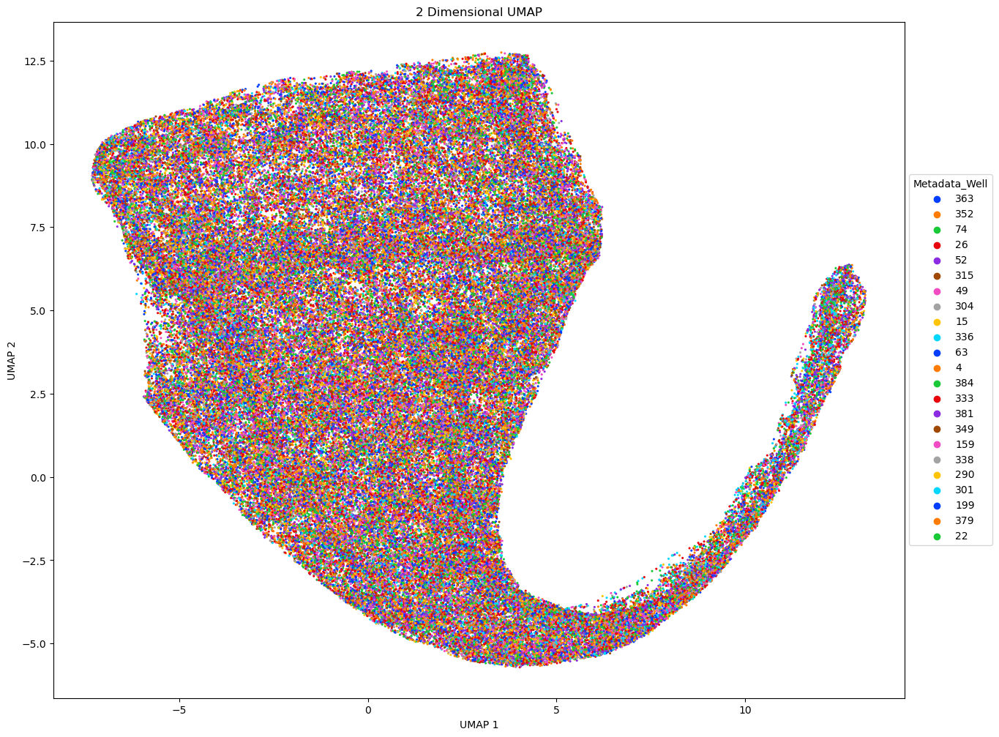

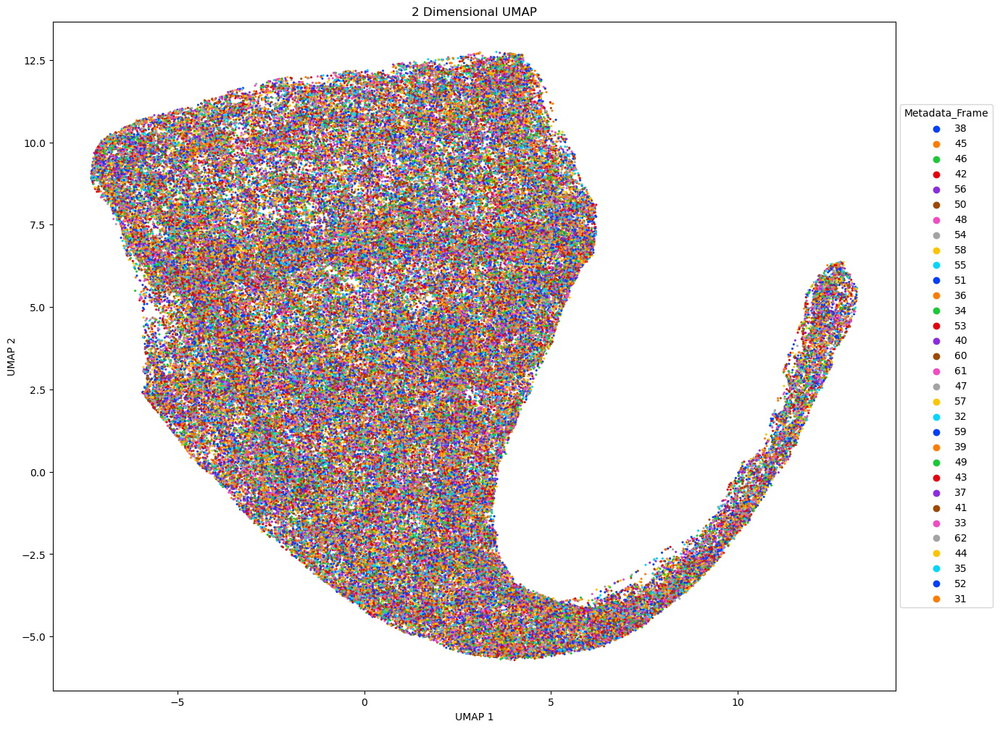

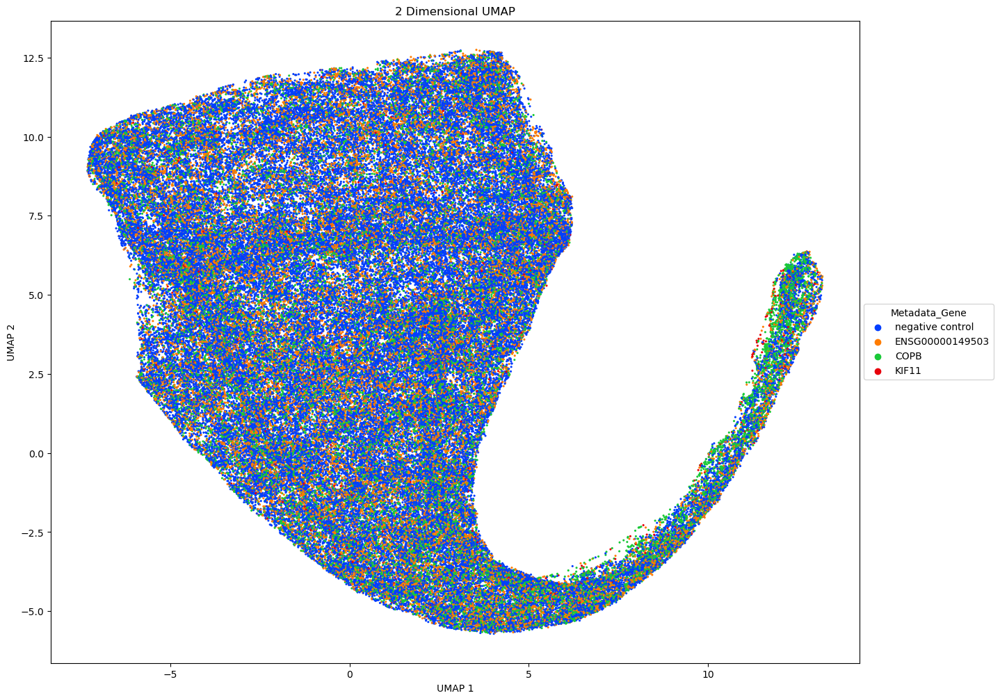

In [3]:
metadata_dataframe, feature_data = split_data(control_data, "CP")
x_data, y_data = get_2D_umap_embeddings(feature_data)

metadata_fields = ["Metadata_Plate", "Metadata_Well", "Metadata_Frame", "Metadata_Gene"]

for metadata_field in metadata_fields:
    metadata = metadata_dataframe[metadata_field]
    show_2D_umap_from_embeddings(x_data, y_data, metadata)

### Create 2D umaps colored by metadata (DP)

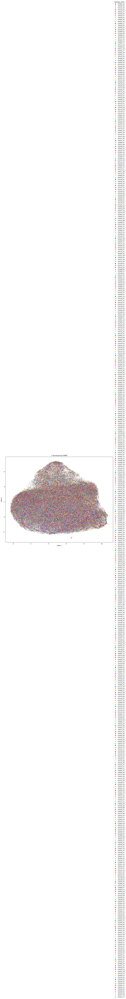

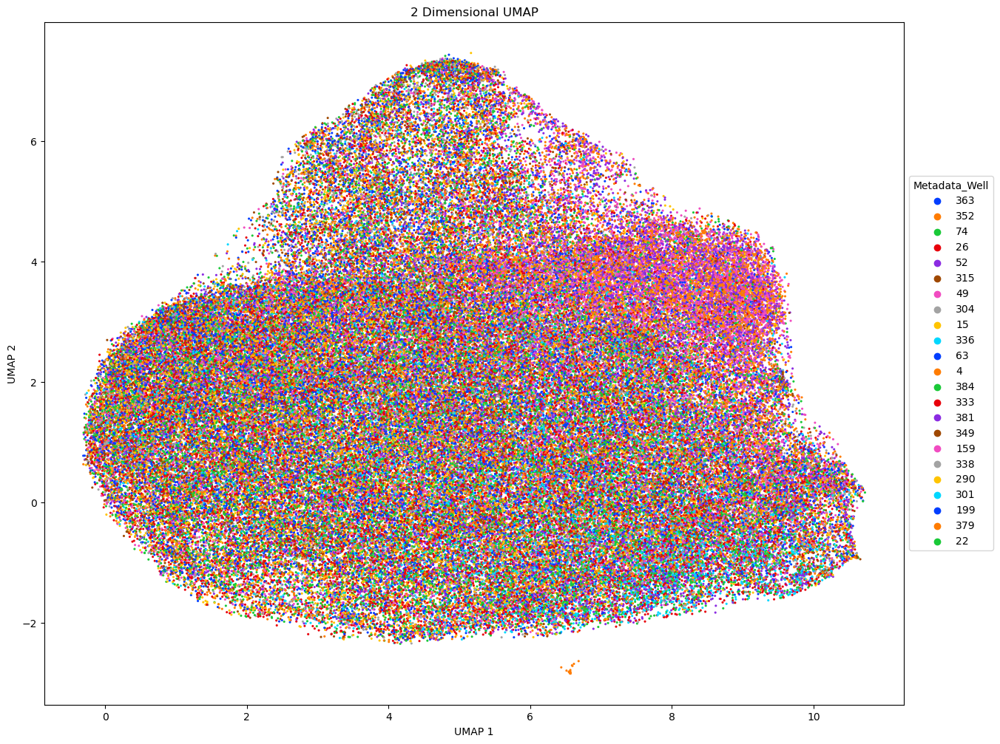

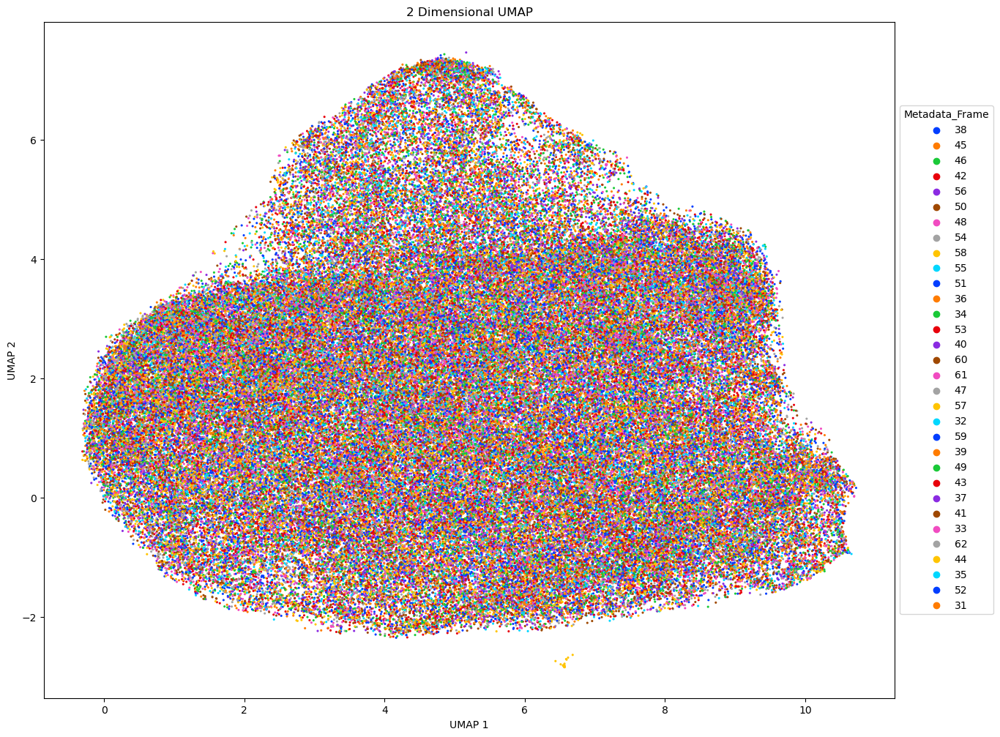

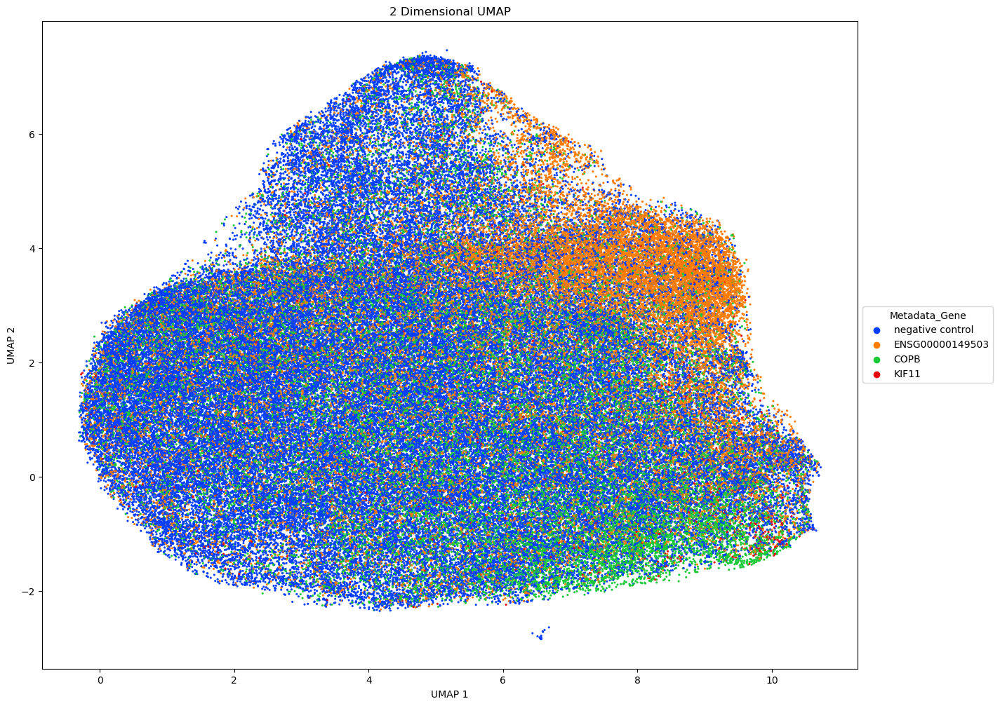

In [4]:
metadata_dataframe, feature_data = split_data(control_data, "DP")
x_data, y_data = get_2D_umap_embeddings(feature_data)

metadata_fields = ["Metadata_Plate", "Metadata_Well", "Metadata_Frame", "Metadata_Gene"]

for metadata_field in metadata_fields:
    metadata = metadata_dataframe[metadata_field]
    show_2D_umap_from_embeddings(x_data, y_data, metadata)

### Create 2D umaps colored by metadata (CP and DP)

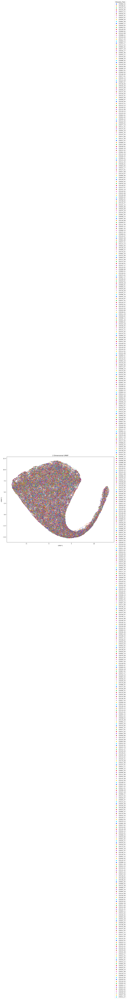

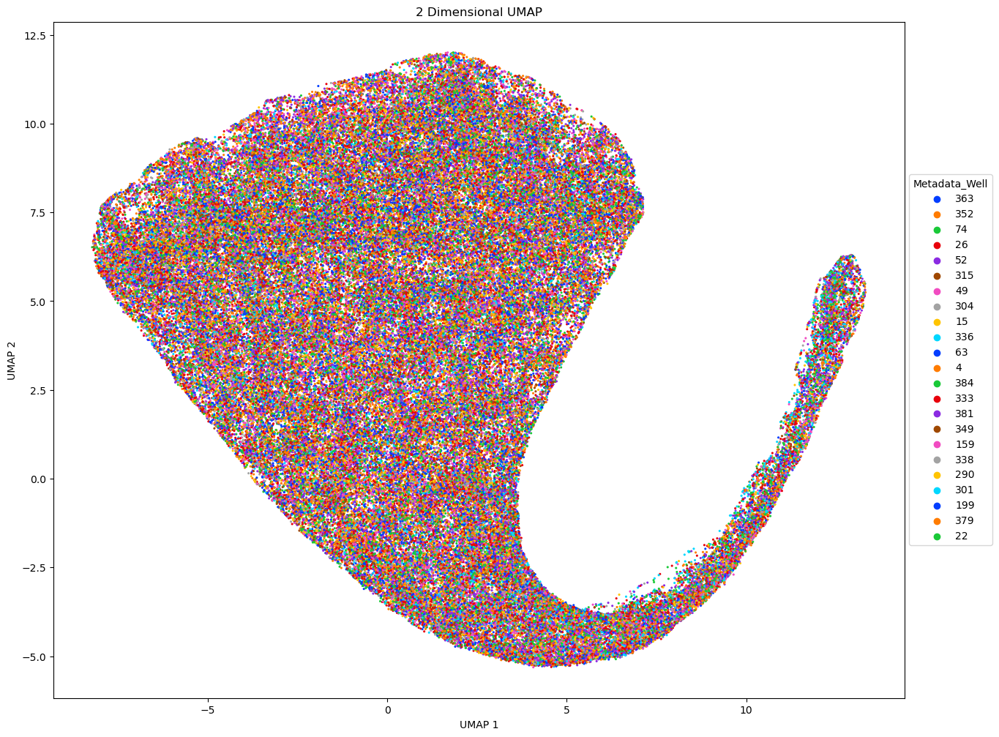

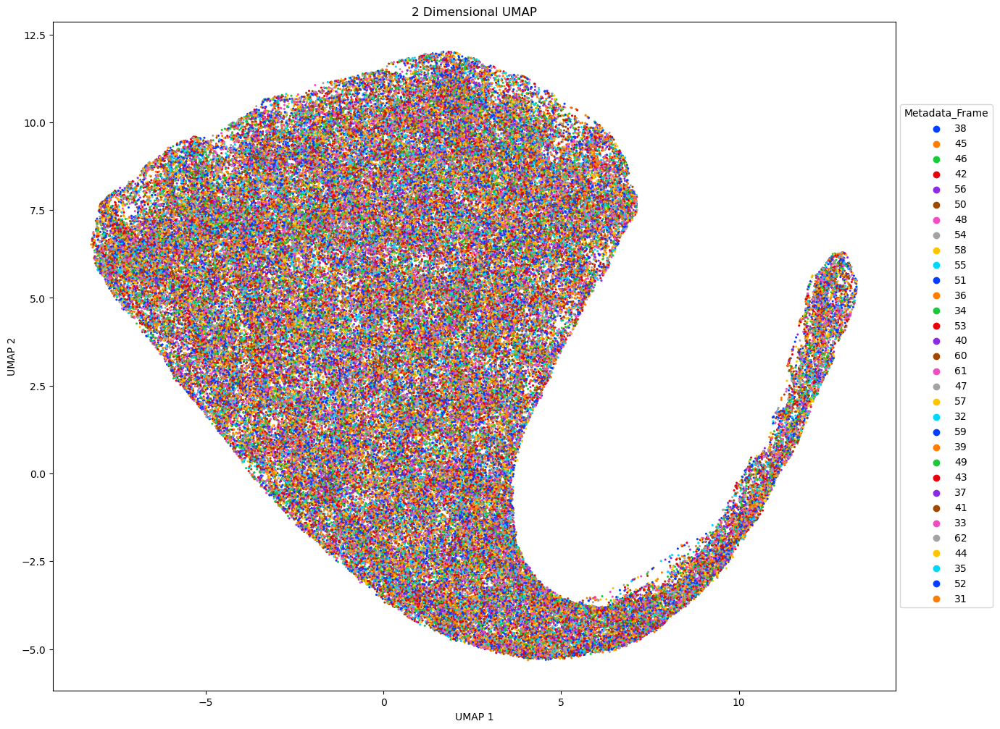

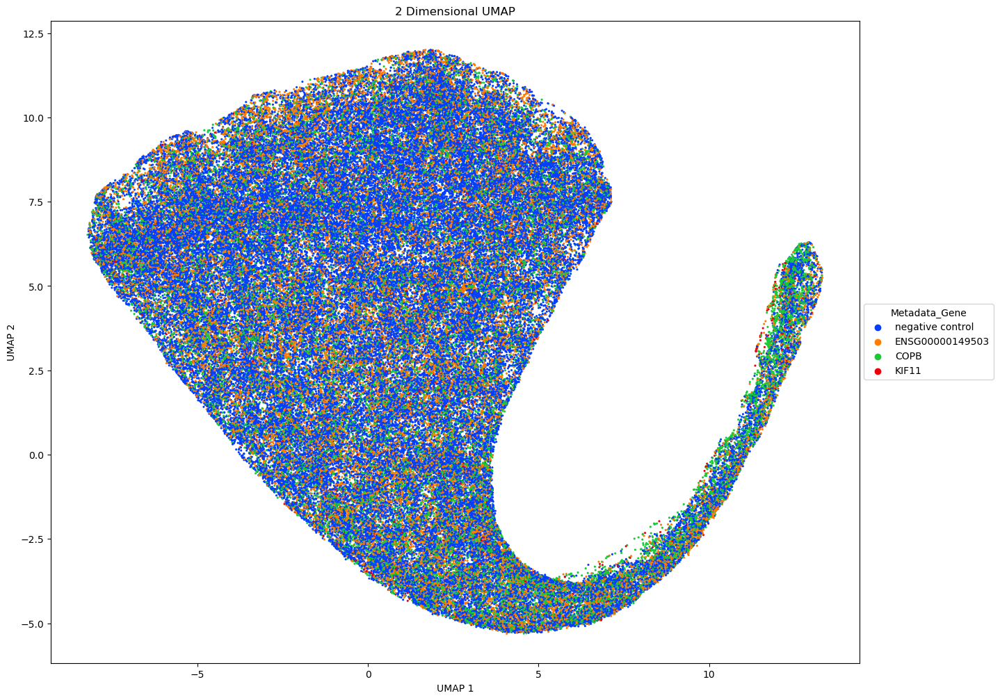

In [5]:
metadata_dataframe, feature_data = split_data(control_data)
x_data, y_data = get_2D_umap_embeddings(feature_data)

metadata_fields = ["Metadata_Plate", "Metadata_Well", "Metadata_Frame", "Metadata_Gene"]

for metadata_field in metadata_fields:
    metadata = metadata_dataframe[metadata_field]
    show_2D_umap_from_embeddings(x_data, y_data, metadata)